In [10]:
import fingerprint
import cv2
import numpy as np
from skimage.util import invert
from gtda.images import RadialFiltration
from gtda.diagrams import Scaler
from gtda.diagrams import HeatKernel
import matplotlib.pyplot as plt

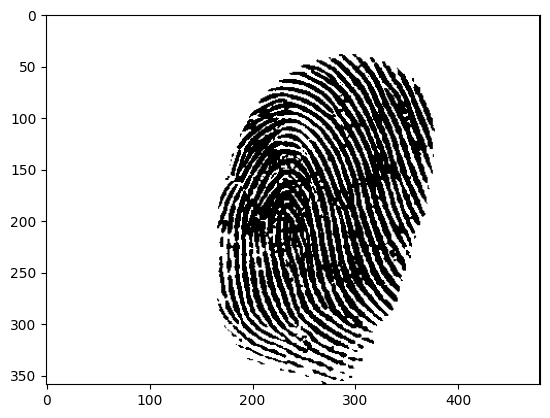

In [16]:
original_img = cv2.imread("images/image_480.png", cv2.IMREAD_ANYCOLOR)

BnW_image = fingerprint.BinarizeFingerprint(original_img, blockSize=200)

# Plotting
plt.imshow(BnW_image, cmap='gray')
plt.show()

In [17]:
radial_filtration = RadialFiltration(center=np.array([150, 50]))
filtered = radial_filtration.fit_transform(np.array([invert(BnW_image)]))
radial_filtration.plot(filtered, colorscale="jet")

In [29]:
diagrams_basic = fingerprint.ToPersistenceDiagram(filtered)
scaler = Scaler()
scaled_diagrams = scaler.fit_transform(diagrams_basic)
x = scaler.plot(scaled_diagrams)
x.show()

In [20]:
h = HeatKernel(sigma=.15, n_bins=60, n_jobs=-1)
h_img = h.fit_transform(scaled_diagrams)
h.plot(h_img, homology_dimension_idx=1, colorscale='jet')


# Pipeline?!

In [33]:
def p(BnW_image, center):
    radial_filtration = RadialFiltration(center=np.array(center))
    filtered = radial_filtration.fit_transform(np.array([invert(BnW_image)]))
    x = radial_filtration.plot(filtered, colorscale="jet")
    x.show()

    diagrams_basic = fingerprint.ToPersistenceDiagram(filtered)
    scaler = Scaler()
    scaled_diagrams = scaler.fit_transform(diagrams_basic)
    x = scaler.plot(scaled_diagrams)
    x.show()

    h = HeatKernel(sigma=.15, n_bins=60, n_jobs=-1)
    h_img = h.fit_transform(scaled_diagrams)
    x = h.plot(h_img, homology_dimension_idx=1, colorscale='jet')
    x.show()

In [35]:
centers = [
    [150, 50],
    [200, 200],
    [300, 250]
]

for center in centers:
    print('------------------------------------------------------------------------------------------------')
    print(f'CENTER: {center}')
    p(BnW_image, center)
    print('------------------------------------------------------------------------------------------------')

------------------------------------------------------------------------------------------------
CENTER: [150, 50]


------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------
CENTER: [200, 200]


------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------
CENTER: [300, 250]


------------------------------------------------------------------------------------------------


# Attempt at Classifier

In [1]:
from sklearn.model_selection import train_test_split
import math
import cv2
import random
import numpy as np
import os
from os import listdir
 
# get the path/directory
folder_dir = "./DB1_B"


# images = [
#     # "image_480.png",
#      "test1.png",
#      "test2.png",
#      "test3.png",
#      "test4.png",
#     # "print2.png"
#     'q.png'
# ]

target_size = (100, 120)  # Set your desired dimensions

X = []
y = []

for images in os.listdir(folder_dir):
 
    # check if the image ends with png
    print(images)

# i = 0
# for img in os.listdir(folder_dir):
#     original_img = cv2.imread(img, cv2.IMREAD_ANYCOLOR)
#     BnW_image = fingerprint.BinarizeFingerprint(original_img, blockSize=200)
#     resized_image = cv2.resize(BnW_image, target_size)
#     X.append(resized_image)
#     y[i] = random.randint(1,2)
#     i += 1
# X = np.array(X)
# print(X,y)

FileNotFoundError: [Errno 2] No such file or directory: './DB1_B'

In [122]:
# train_size = math.ceil(0.7*len(images))
# test_size = len(images) - train_size
train_size = 0.6
test_size = 0.4

X = X.reshape((-1, X.shape[1], X.shape[2]))
X_train, X_test, y_train, y_test = train_test_split(
    X, y, train_size=train_size, test_size=test_size, stratify=y, random_state=666
)

print(f"X_train shape: {X_train.shape}, y_train shape: {y_train.shape}")
print(f"X_test shape: {X_test.shape}, y_test shape: {y_test.shape}")

X_train shape: (3, 100, 100), y_train shape: (3,)
X_test shape: (2, 100, 100), y_test shape: (2,)


In [119]:
from sklearn.pipeline import make_pipeline, make_union
from gtda.diagrams import PersistenceEntropy
from gtda.images import HeightFiltration
from gtda.homology import VietorisRipsPersistence
from gtda.diagrams import Amplitude

direction_list = [[1, 0], [1, 1], [0, 1], [-1, 1], [-1, 0], [-1, -1], [0, -1], [1, -1]]

center_list = [
    [13, 6],
    [6, 13],
    [13, 13],
    [20, 13],
    [13, 20],
    [6, 6],
    [6, 20],
    [20, 6],
    [20, 20],
]

# Creating a list of all filtration transformer, we will be applying
filtration_list = (
    [
        HeightFiltration(direction=np.array(direction), n_jobs=-1)
        for direction in direction_list
    ]
    + [RadialFiltration(center=np.array(center), n_jobs=-1) for center in center_list]
)

# Creating the diagram generation pipeline
diagram_steps = [
    [
        filtration,
        VietorisRipsPersistence(n_jobs=-1),
        Scaler(n_jobs=-1),
    ]
    for filtration in filtration_list
]

# Listing all metrics we want to use to extract diagram amplitudes
metric_list = [
    {"metric": "bottleneck", "metric_params": {}},
    {"metric": "wasserstein", "metric_params": {"p": 1}},
    {"metric": "wasserstein", "metric_params": {"p": 2}},
    {"metric": "landscape", "metric_params": {"p": 1, "n_layers": 1, "n_bins": 100}},
    {"metric": "landscape", "metric_params": {"p": 1, "n_layers": 2, "n_bins": 100}},
    {"metric": "landscape", "metric_params": {"p": 2, "n_layers": 1, "n_bins": 100}},
    {"metric": "landscape", "metric_params": {"p": 2, "n_layers": 2, "n_bins": 100}},
    {"metric": "betti", "metric_params": {"p": 1, "n_bins": 100}},
    {"metric": "betti", "metric_params": {"p": 2, "n_bins": 100}},
    {"metric": "heat", "metric_params": {"p": 1, "sigma": 1.6, "n_bins": 100}},
    {"metric": "heat", "metric_params": {"p": 1, "sigma": 3.2, "n_bins": 100}},
    {"metric": "heat", "metric_params": {"p": 2, "sigma": 1.6, "n_bins": 100}},
    {"metric": "heat", "metric_params": {"p": 2, "sigma": 3.2, "n_bins": 100}},
]

#
feature_union = make_union(
    *[PersistenceEntropy(nan_fill_value=-1)]
    + [Amplitude(**metric, n_jobs=-1) for metric in metric_list]
)

tda_union = make_union(
    *[make_pipeline(*diagram_step, feature_union) for diagram_step in diagram_steps],
    n_jobs=-1
)

In [123]:

X_train_tda = tda_union.fit_transform(X_train)
X_train_tda.shape

/Users/alejandrobreen/opt/anaconda3/lib/python3.9/site-packages/gtda/homology/simplicial.py:232: DataDimensionalityWarning: Input array X has X.shape[1] == X.shape[2]. This is consistent with a collection of distance/adjacency matrices, but the input is being treated as a collection of vectors in Euclidean space.
  check_point_clouds(X, accept_sparse=True,
/Users/alejandrobreen/opt/anaconda3/lib/python3.9/site-packages/gtda/homology/simplicial.py:299: DataDimensionalityWarning: Input array X has X.shape[1] == X.shape[2]. This is consistent with a collection of distance/adjacency matrices, but the input is being treated as a collection of vectors in Euclidean space.
  X = check_point_clouds(X, accept_sparse=True,
/Users/alejandrobreen/opt/anaconda3/lib/python3.9/site-packages/gtda/homology/simplicial.py:232: DataDimensionalityWarning: Input array X has X.shape[1] == X.shape[2]. This is consistent with a collection of distance/adjacency matrices, but the input is being treated as a colle

(3, 476)

In [125]:
from sklearn.ensemble import RandomForestClassifier

rf = RandomForestClassifier()
rf.fit(X_train_tda, y_train)

X_test_tda = tda_union.transform(X_test)
rf.score(X_test_tda, y_test)

/Users/alejandrobreen/opt/anaconda3/lib/python3.9/site-packages/gtda/homology/simplicial.py:299: DataDimensionalityWarning: Input array X has X.shape[1] == X.shape[2]. This is consistent with a collection of distance/adjacency matrices, but the input is being treated as a collection of vectors in Euclidean space.
  X = check_point_clouds(X, accept_sparse=True,
/Users/alejandrobreen/opt/anaconda3/lib/python3.9/site-packages/gtda/homology/simplicial.py:299: DataDimensionalityWarning: Input array X has X.shape[1] == X.shape[2]. This is consistent with a collection of distance/adjacency matrices, but the input is being treated as a collection of vectors in Euclidean space.
  X = check_point_clouds(X, accept_sparse=True,
/Users/alejandrobreen/opt/anaconda3/lib/python3.9/site-packages/gtda/homology/simplicial.py:299: DataDimensionalityWarning: Input array X has X.shape[1] == X.shape[2]. This is consistent with a collection of distance/adjacency matrices, but the input is being treated as a c

0.5